In [157]:
using Flight.FlightCore
using Flight.FlightLib
using Flight.FlightAircraft
using Flight.FlightAircraft.C172X.C172XControl
using Flight.FlightLib.Control.Continuous: LinearizedSS, submodel
using Flight.FlightLib.Control.Discrete: PIDParams
using Flight.FlightLib.Control.PIDOpt: Settings, Metrics, optimize_PID, build_PID, check_results

using UnPack
using ControlSystems
using RobustAndOptimalControl
using ComponentArrays
using LinearAlgebra
using Plots

In [158]:
global_search = false


ac = Cessna172Xv0(NED()) |> Model #linearization requires NED kinematics

h = 50
EAS = 25
flaps = EAS < 30 ? 1.0 : 0.0
payload = C172.PayloadY()
# payload = C172.PayloadY(m_pilot = 100, m_copilot = 100, m_baggage = 0)
design_point = C172.TrimParameters(; Ob = Geographic(LatLon(), HEllip(h)), EAS, flaps, payload)
# design_point = C172.TrimParameters()

#complete longitudinal model
lss_full = Control.Continuous.LinearizedSS(ac, design_point; model = :lon);
P_full = named_ss(lss_full);

x_labels_full = keys(lss_full.x0) |> collect
y_labels_full = keys(lss_full.y0) |> collect
u_labels_full = keys(lss_full.u0) |> collect

lss_full.A[:h, :] |> display
lss_full.A[:, :h] |> display
lss_full.C[:, :h] |> display


ComponentVector{Float64}(q = 0.0, θ = 25.039442598819733, v_x = 0.23912102474459968, v_z = -0.9709832602928575, h = 0.0, α_filt = 0.0, ω_eng = 0.0, thr_p = 0.0, ele_p = 0.0)

ComponentVector{Float64}(q = 8.480241106029184e-7, θ = -6.241444494787516e-13, v_x = -0.00022017982083049503, v_z = 0.0009093001047603977, h = 0.0, α_filt = 0.0, ω_eng = -0.03418840680803572, thr_p = 0.0, ele_p = 0.0)

ComponentVector{Float64}(q = 0.0, θ = 0.0, v_x = 0.0, v_z = 0.0, h = 1.0, α_filt = 0.0, ω_eng = 0.0, thr_p = 0.0, ele_p = 0.0, f_x = -0.00022040069103240967, f_z = 0.0009122800827026367, α = 0.0, EAS = -0.0012009191513061524, TAS = 0.0, γ = 0.0, climb_rate = 0.0, throttle_cmd = 0.0, elevator_cmd = 0.0)

As one would expect, $\dot{h}$ is nonzero for nonzero $\theta$, $v_x$ or $v_z$. This can be an issue
when designing a LQR tracker, which requires a combination of reference values $\Delta x^*$ and
$\Delta u^*$ that achieve static equilibrium for an arbitrary reference command vector $\Delta z^*$.
If such static equilibrium does not exist, the block $H_x F^{-1} G$, whose inverse is involved in
the computation of the feedforward gain matrix, will be singular.

The presence of $h$ in the state vector means that, for most choices of longitudinal command
variables, this static equilibrium indeed does not exist. This should be intuitively obvious, since
in general any useful command we might want to track will involve $\dot{h} \neq 0$. This would not
be the case if we picked for instance $h$ and $EAS$ as command variables, because true equilibrium
with $\dot{h}=0$ exists for an arbitrary combination of the two. However, this is not an appealing
choice, because we would like to control the pitch axis explicitly, rather than implicitly through
$h$.

A possible solution might be to partition the state and work with quasi-static equilibrium (see
Stengel). But there is another problem: the coupling of $h$ into the engine model introduces an
uncontrollable pole, whose effects are particularly noticeable in the throttle's dynamic response.

Since the coupling of $h$ into the remaining states is very weak, we can avoid the inconvenience by
simply dropping $h$ from the state. We then design the controlleres on the reduced plant, and
connect back to the full plant those might need later on for the altitude hold design.

In [159]:
x_labels_red = copy(x_labels_full)
y_labels_red = copy(y_labels_full)
u_labels_red = copy(u_labels_full)

x_labels_red = deleteat!(x_labels_red, findfirst(isequal(:h), x_labels_red))
y_labels_red = deleteat!(y_labels_red, findfirst(isequal(:h), y_labels_red))

lss_red = submodel(lss_full; x = x_labels_red, u = u_labels_red, y = y_labels_red)
P_red = submodel(P_full; x = x_labels_red, u = u_labels_red, y = y_labels_red)


NamedStateSpace{Continuous, Float64}
A = 
 -2.7397732857693633  -3.6520873055306824e-6   0.8916606961524536     -3.7635049465329145     79.00807407255608     0.004150020352009965      0.0               3.7724025793225926
  0.9999932913135848  -6.557486206696814e-14   1.5326199992959291e-7   3.774284773007262e-8    0.0                  0.0                       0.0               0.0
 -4.155995950270756   -9.496449241865097      -0.6778628250595742      2.8274723111592097    -51.943668877350206    0.02035485669280318       0.0              -2.73825665299044
 23.580134650080282   -2.338617790271881      -0.30981807272305134    -1.9145923444204986     16.670145006193774   -1.3870400377210604e-6     0.0               1.1696052867795497
  0.0                  0.0                    -0.4774915435547402      1.938918989738569     -50.0                  0.0                       0.0               0.0
  2.632293701171875    0.0                     8.051729606906774       1.9828789280444337      

In [160]:
dampreport(P_full)
dampreport(P_red)

|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| -0.00072           |  1            |  0.00072      |  0.000115     |  1.39e+03     |
| -0.0621 ±  0.475im |  0.129        |  0.48         |  0.0763       |  16.1         |
| -2.85   ±   3.61im |  0.62         |  4.6          |  0.731        |  0.351        |
| -10.6              |  1            |  10.6         |  1.69         |  0.0941       |
| -20                |  1            |  20           |  3.18         |  0.05         |
| -20                |  1            |  20           |  3.18         |  0.05         |
| -49.5              |  1            |  49.5         |  7.88         |  0.0202       |
|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (r

In [161]:
cond(P_full.A) |> display
cond(P_red.A) |> display

3.5534649209698565e7

96676.42601816823

## 1. Pitch Stability Augmentation

We now tackle the design of a throttle-decoupled LQR tracker as a pitch SAS, with only elevator as
both command variable and control input. Therefore, steady-state errors are of little importance;
the actual tracking of longitudinal command variables ($q$, $\theta$) will be handled by outer
feedback loops.

We will use a SISO model retaining only pitch dynamics. Since we are only keeping elevator command
as an input, we also need to drop all engine-related states in addition to $h$ in order to keep the
system controllable.

In [162]:
x_labels_pit = [:q, :θ, :v_x, :v_z, :α_filt, :ele_p]
y_labels_pit = vcat(x_labels_pit, [:f_x, :f_z, :α, :EAS, :TAS, :γ, :climb_rate, :elevator_cmd])
u_labels_pit = [:elevator_cmd,]

#pitch dynamics model
lss_pit = submodel(lss_full; x = x_labels_pit, u = u_labels_pit, y = y_labels_pit)
P_pit = named_ss(lss_pit);

In [163]:
dampreport(P_red)
dampreport(P_pit)

|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| -0.0624 ±  0.475im |  0.13         |  0.479        |  0.0762       |  16           |
| -2.85   ±   3.61im |  0.62         |  4.6          |  0.731        |  0.351        |
| -10.6              |  1            |  10.6         |  1.69         |  0.0941       |
| -20                |  1            |  20           |  3.18         |  0.05         |
| -20                |  1            |  20           |  3.18         |  0.05         |
| -49.5              |  1            |  49.5         |  7.88         |  0.0202       |
|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+-----

In [164]:
cond(P_red.A) |> display
cond(P_pit.A) |> display

96676.42601816823

4687.530852058375

In [165]:
# ensure consistency in component selection and ordering between our pitch
# design model and avionics implementation for state and control vectors
@assert tuple(x_labels_pit...) === propertynames(C172XControl.XPitch())
# @assert tuple(u_labels_pit...) === propertynames(C172XControl.UPitch())

x_trim = lss_pit.x0
u_trim = lss_pit.u0

n_x = length(x_labels_pit)
n_u = length(u_labels_pit)

@show tuple(x_labels_pit...)
@show propertynames(C172XControl.XPitch())

tuple(x_labels_pit...) = (:q, :θ, :v_x, :v_z, :α_filt, :ele_p)
propertynames(C172XControl.XPitch()) = (:q, :θ, :v_x, :v_z, :α_filt, :ele_p)


(:q, :θ, :v_x, :v_z, :α_filt, :ele_p)

In [166]:
z_labels = [:elevator_cmd,]

# @assert tuple(z_labels...) === propertynames(C172XControl.ZPitch())
z_trim = lss_pit.y0[z_labels]
n_z = length(z_labels)

F = lss_pit.A
G = lss_pit.B
Hx = lss_pit.C[z_labels, :]
Hu = lss_pit.D[z_labels, :]

@unpack v_x, v_z = lss_pit.x0
v_norm = norm([v_x, v_z])

#weight matrices
Q = C172XControl.XPitch(q = 1, θ = 20, v_x = 0.1/v_norm, v_z = 1/v_norm, α_filt = 0, ele_p = 0) |> diagm
# R = C172XControl.UPitch(elevator_cmd = 2) |> diagm
R = [2.0] |> diagm #elevator_cmd weight

#feedback gain matrix
C_fbk = lqr(P_pit, Q, R)

#forward gain matrix
A = [F G; Hx Hu]
B = inv(A)
B_12 = B[1:n_x, n_x+1:end]
B_22 = B[n_x+1:end, n_x+1:end]
C_fwd = B_22 + C_fbk * B_12

#no integral control
C_int = zeros(n_u, n_z)

#useful signal labels
u_labels_pit_fbk = Symbol.(string.(u_labels_pit) .* "_fbk")
u_labels_pit_fwd = Symbol.(string.(u_labels_pit) .* "_fwd")
u_labels_pit_sum = Symbol.(string.(u_labels_pit) .* "_sum")
z_labels_ref = Symbol.(string.(z_labels) .* "_ref")

C_fbk_ss = named_ss(ss(C_fbk), u = x_labels_pit, y = u_labels_pit_fbk)
C_fwd_ss = named_ss(ss(C_fwd), u = z_labels_ref, y = u_labels_pit_fwd)

#summing junctions
# throttle_sum = sumblock("throttle_cmd_sum = throttle_cmd_fwd- throttle_cmd_fbk")
elevator_sum = sumblock("elevator_cmd_sum = elevator_cmd_fwd - elevator_cmd_fbk")

connections = vcat(
    Pair.(x_labels_pit, x_labels_pit),
    Pair.(u_labels_pit_fbk, u_labels_pit_fbk),
    Pair.(u_labels_pit_sum, u_labels_pit),
    Pair.(u_labels_pit_fwd, u_labels_pit_fwd)
    )


9-element Vector{Pair{Symbol, Symbol}}:
                :q => :q
                :θ => :θ
              :v_x => :v_x
              :v_z => :v_z
           :α_filt => :α_filt
            :ele_p => :ele_p
 :elevator_cmd_fbk => :elevator_cmd_fbk
 :elevator_cmd_sum => :elevator_cmd
 :elevator_cmd_fwd => :elevator_cmd_fwd

Now, after designing the LQR tracker on the pitch dynamics plant, we connect it to the reduced longitudinal dynamics.

In [167]:
#connect to the pitch dynamics (this one is for comparison only)
P_pit_te = connect([P_pit, elevator_sum, C_fbk_ss, C_fwd_ss],
    connections; w1 = z_labels_ref, z1 = P_pit.y)

#connect to the complete longitudinal dynamics (this is the one we'll keep)
P_red_te = connect([P_red, elevator_sum, C_fbk_ss, C_fwd_ss],
    connections; w1 = [:throttle_cmd, :elevator_cmd_ref], z1 = P_red.y)

#add dummy system to rename input throttle_cmd to throttle_cmd_ref
D_thr = named_ss(ss(1), u = [:throttle_cmd_ref,], y = [:throttle_cmd_ref, ])
P_red_te = connect([P_red_te, D_thr], [:throttle_cmd_ref => :throttle_cmd,];
    w1 = [:throttle_cmd_ref, :elevator_cmd_ref], z1 = P_red_te.y)

display(C_fbk_ss)
display(C_fwd_ss)
dampreport(P_pit_te)
dampreport(P_red_te)

NamedStateSpace{Continuous, Float64}
D = 
 0.529402640038334  2.820165783860275  0.022701685896661515  -0.07479123179712331  0.7880131669742335  0.0884613278488888

Continuous-time state-space model
With state  names: 
     input  names: q θ v_x v_z α_filt ele_p
     output names: elevator_cmd_fbk


NamedStateSpace{Continuous, Float64}
D = 
 1.3400769806690822

Continuous-time state-space model
With state  names: 
     input  names: elevator_cmd_ref
     output names: elevator_cmd_fwd


|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| -0.262  ±  0.402im |  0.546        |  0.479        |  0.0763       |  3.82         |
| -3.62   ±   3.87im |  0.683        |  5.3          |  0.844        |  0.276        |
| -19.8              |  1            |  19.8         |  3.16         |  0.0504       |
| -49.5              |  1            |  49.5         |  7.88         |  0.0202       |
|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| -0.253  ±  0.402im |  0.533        |  0.475        |  0.0756       |  3.95         |
| -3.62   ±   3.87im |  0.683        |  5.3

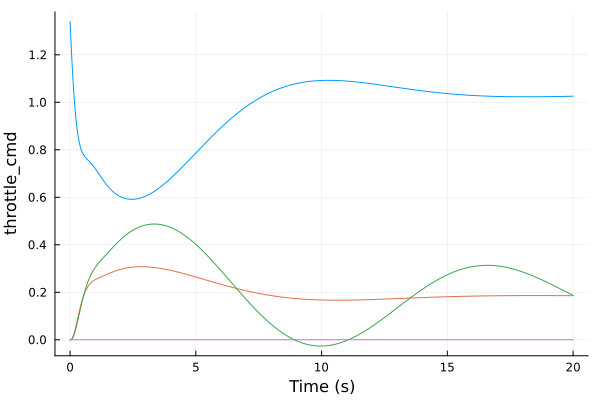

In [168]:
e2e_SAS = P_red_te[:elevator_cmd, :elevator_cmd_ref]
e2θ_SAS = P_red_te[:θ, :elevator_cmd_ref]
e2θ_ol = P_red[:θ, :elevator_cmd]
e2t_SAS = P_red_te[:throttle_cmd, :elevator_cmd_ref]
step(e2e_SAS, 20) |> plot
step(e2θ_SAS, 20) |> plot!
step(e2θ_ol, 20) |> plot!
step(e2t_SAS, 20) |> plot!

Since we have computed the feedforward gain for the reduced pitch dynamics (instead of the complete,
longitudinal dynamics, including the power plant), we get a small but non-zero steady state error
when tracking elevator commands. This would not happen had we used the complete longitudinal MIMO
system for the LQR tracker design. However, in that case, the off-diagonal elements in the 2x2
feedforward matrix would couple elevator and throttle commands. As a consequence, changing the
elevator command reference would result in throttle activity, which is not a desirable behaviour. 

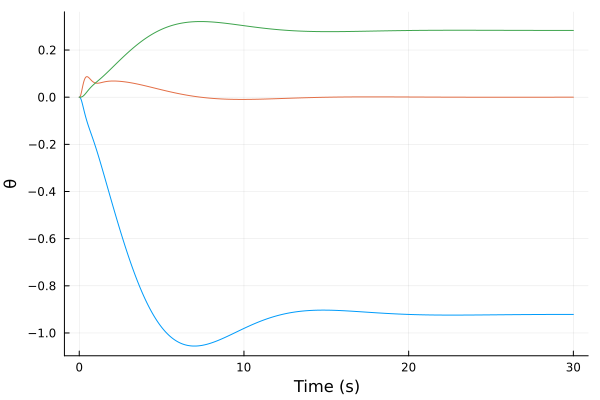

In [169]:
t2e_SAS = P_red_te[:elevator_cmd, :throttle_cmd_ref]
# t2v_SAS = P_red_te[:EAS, :throttle_cmd_ref]
t2q_SAS = P_red_te[:q, :throttle_cmd_ref]
t2θ_SAS = P_red_te[:θ, :throttle_cmd_ref]
# step(t2t_SAS, 30) |> plot
# step(t2v_SAS, 30) |> plot!
step(t2e_SAS, 30) |> plot
step(t2q_SAS, 30) |> plot!
step(t2θ_SAS, 30) |> plot!

## 2. $q \rightarrow e$

We now design a pitch rate to elevator CAS on top of the stabilized plant using classical SISO techniques.

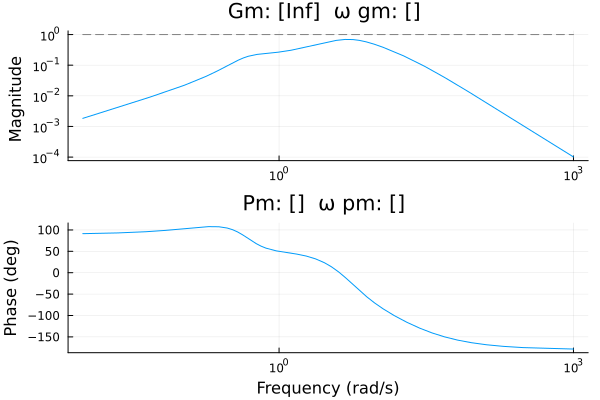

In [170]:
P_e2q = P_red_te[:q, :elevator_cmd_ref]
marginplot(P_e2q)

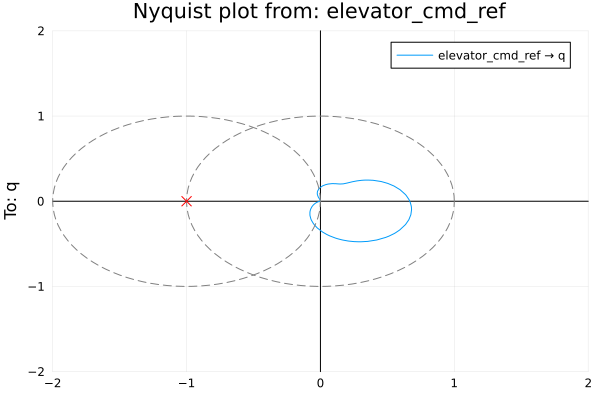

In [171]:
nyquistplot(P_e2q; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

The open loop gain goes to zero for $\omega\rightarrow 0$, so we will need two integrators in the loop transfer function in order to achieve a type-1 system and eliminate steady-state error. One of them will be a standalone integrator, the other one will be provided by the PID. 

In [172]:
q2e_int = tf(1, [1, 0]) |> ss
P_q2e_opt = series(q2e_int, ss(P_e2q))

t_sim_q2e = 10
lower_bounds = PIDParams(; k_p = 0.1, k_i = 0.0, k_d = 0.0, τ_f = 0.01)
upper_bounds = PIDParams(; k_p = 10.0, k_i = 50.0, k_d = 2.0, τ_f = 0.01)
settings = Settings(; t_sim = t_sim_q2e, lower_bounds, upper_bounds)
weights = Metrics(; Ms = 1, ∫e = 15, ef = 2, ∫u = 0.1, up = 0.00)
params_0 = PIDParams(; k_p = 2.0, k_i = 15, k_d = 0.4, τ_f = 0.01)

q2e_results = optimize_PID(P_q2e_opt; params_0, settings, weights, global_search)

@unpack k_p, k_i, k_d, T_i, T_d = q2e_results.params
@unpack k_p, k_i, k_d, T_i, T_d = q2e_results.params
@show k_p, k_i, k_d, T_i, T_d
@show q2e_results.metrics
@show q2e_results.exit_flag

(k_p, k_i, k_d, T_i, T_d) = (8.31163319536938, 41.03101935583328, 1.5216818158566128, 0.2025695029238345, 0.18307855749750604)
q2e_results.metrics = [1.2747608198868092, 0.024611439428357466, 0.0025438514139771717, 3.2374041752440066, 159.47981478103065]
q2e_results.exit_flag = :ROUNDOFF_LIMITED


:ROUNDOFF_LIMITED

In [173]:
q2e_PID = build_PID(q2e_results.params)
# q2e_PID = build_PID(PIDParams(; k_p = 1.594, k_i = 15.216, k_d = 0.102))
C_q2e = named_ss(series(q2e_int, q2e_PID), :C_q2e; u = :q_err, y = :elevator_cmd_ref);

StepInfo:
Initial value:     0.000
Final value:       0.997
Step size:         0.997
Peak:              1.093
Peak time:         0.710 s
Overshoot:          9.61 %
Undershoot:         0.00 %
Settling time:     1.292 s
Rise time:         0.191 s


ε_q2e_cl(0) = [0.0;;]


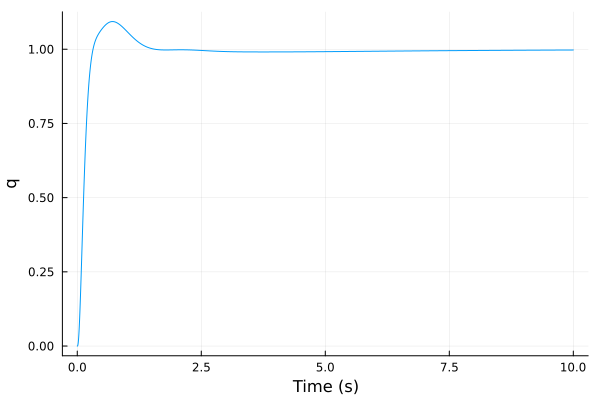

In [174]:
#steady-state error for a unit step input, now zero
L_q2e = series(C_q2e, P_e2q)
ε_q2e_cl = 1/(1+tf(L_q2e))
@show ε_q2e_cl(0)

T_q2e = output_comp_sensitivity(P_e2q, C_q2e) #this is the closed loop transfer function
T_q2e_step = step(T_q2e, t_sim_q2e)
stepinfo(T_q2e_step) |> display
T_q2e_step |> plot

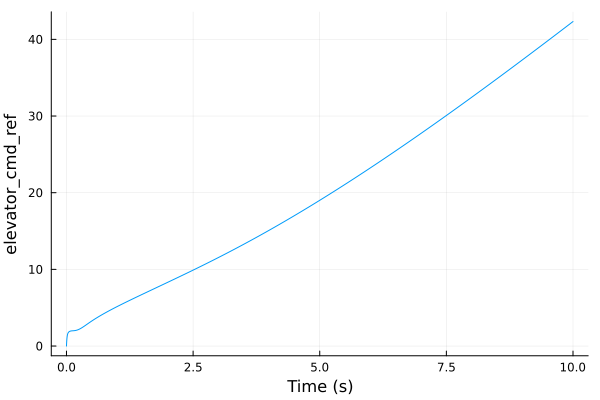

In [175]:
CS_q2e = G_CS(P_e2q, C_q2e)
CS_q2e_step = step(CS_q2e, t_sim_q2e)
CS_q2e_step |> plot

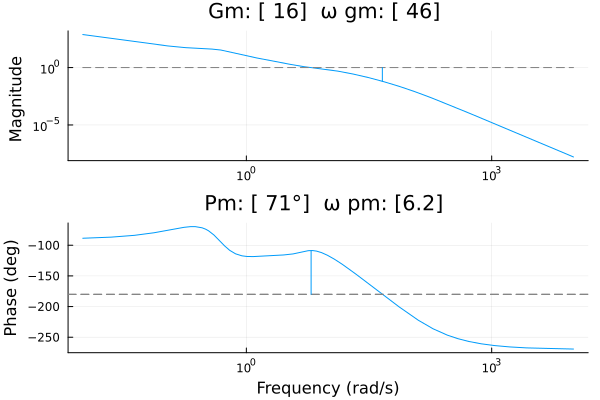

In [176]:
marginplot(L_q2e)

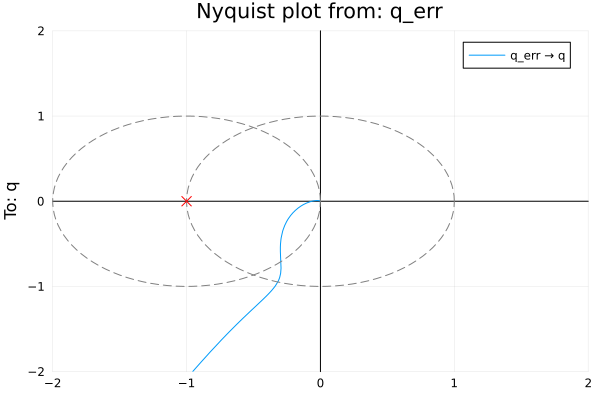

In [105]:
nyquistplot(L_q2e; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

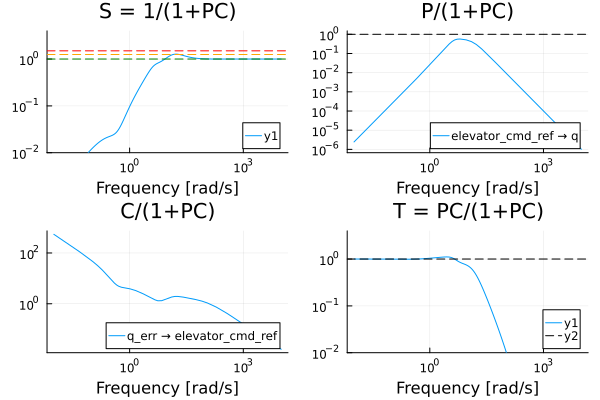

In [177]:
gangoffourplot(P_e2q, C_q2e)

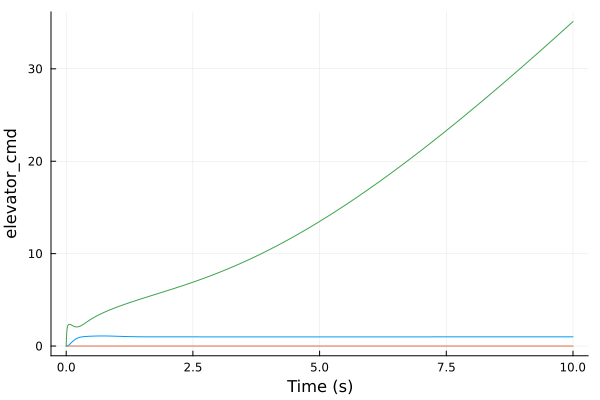

In [179]:
q2e_sum = sumblock("q_err = q_ref - q")
P_red_tq = connect([P_red_te, q2e_sum, C_q2e], [:q_err=>:q_err, :q=>:q, :elevator_cmd_ref=>:elevator_cmd_ref], w1 = [:throttle_cmd_ref, :q_ref], z1 = P_red_te.y)

#verify we get the same response as with the SISO closed loop
qsp2q = P_red_tq[:q, :q_ref]
qsp2t = P_red_tq[:throttle_cmd, :q_ref]
qsp2e = P_red_tq[:elevator_cmd, :q_ref]
step(qsp2q, t_sim_q2e) |> plot
step(qsp2t, t_sim_q2e) |> plot!
step(qsp2e, t_sim_q2e) |> plot!
#and we see that the response matches that of the SISO design

In [180]:
dampreport(P_red_tq)

|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| -6.46e-06          |  1            |  6.46e-06     |  1.03e-06     |  1.55e+05     |
| -0.258             |  1            |  0.258        |  0.041        |  3.88         |
| -0.963             |  1            |  0.963        |  0.153        |  1.04         |
| -2.27   ±   3.78im |  0.515        |  4.41         |  0.702        |  0.441        |
| -10.6              |  1            |  10.6         |  1.69         |  0.094        |
| -9.92   ±   9.69im |  0.715        |  13.9         |  2.21         |  0.101        |
| -20                |  1            |  20           |  3.18         |  0.05         |
| -49.5              |  1            |  49.5         |  7.88         |  0.0202       |
| -102               |  1            |  102

To avoid transients on mode changes, we want the initial output of the pitch rate loop to match the current value of the elevator command reference at the pitch SAS input, $e_{cmd,ref}$.

Whenever pitch rate mode is enabled after a mode change, we first reset both the integrator and the PID. Then we set PID integrator's state to the appropriate value to achieve the required $e_{cmd,ref}$. We have:
$$ y_{int} = 0 $$
$$ y_{pid} = k_p y_{int} + k_i x_{i0} = k_i x_{i0} = e_{cmd,ref} $$

Therefore:
$$x_{i0} = e_{cmd, ref}/k_i$$

## 3. $\theta \rightarrow q$


We start with the pitch-rate augmented plant, with throttle and elevator inputs.

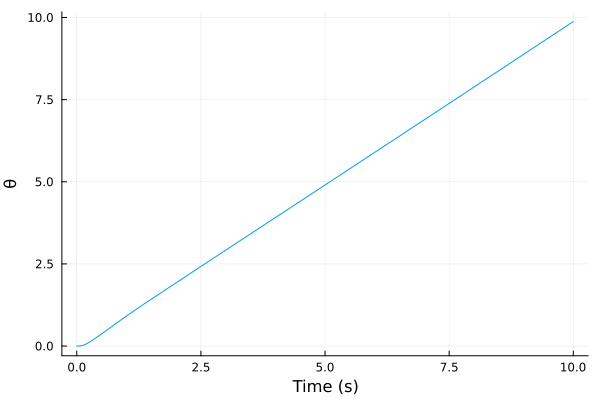

In [181]:
P_q2θ = P_red_tq[:θ, :q_ref]
step(P_q2θ, 10) |> plot

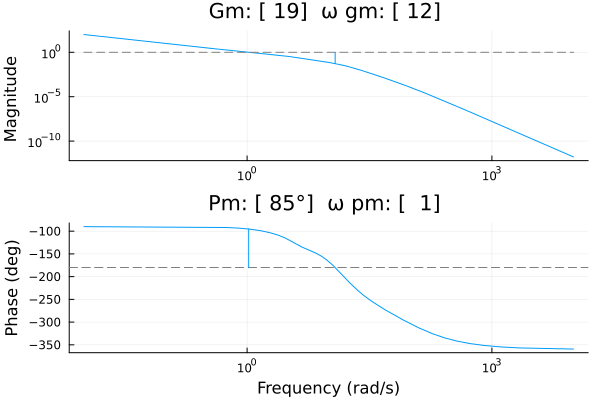

In [182]:
marginplot(P_q2θ)

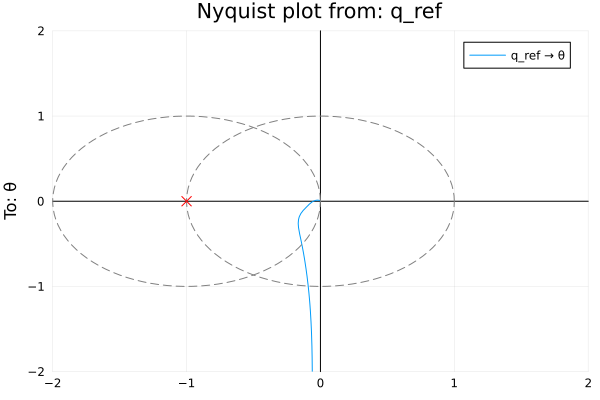

In [183]:
nyquistplot(P_q2θ; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

In [187]:
k_p_θ2q = 1
T_i_θ2q = Inf
T_d_θ2q = 0.0
τ_f_θ2q = 0.01
@show k_i_θ2q= k_p_θ2q/ T_i_θ2q
@show k_d_θ2q= k_p_θ2q* T_d_θ2q

θ2q_pid = k_p_θ2q * (1 + 1/T_i_θ2q * tf(1, [1, 0]) + T_d_θ2q * tf([1, 0], [τ_f_θ2q, 1]))
C_θ2q = θ2q_pid
C_θ2q = named_ss(ss(C_θ2q), :C_θ2q; u = :θ_err, y = :q_ref);
L_θ2q = series(C_θ2q, P_q2θ);

k_i_θ2q = k_p_θ2q / T_i_θ2q = 0.0
k_d_θ2q = k_p_θ2q * T_d_θ2q = 0.0


Testing this simple unit gain feedback design, we find out that it works well for the whole EAS range, so for now it does not seem warranted to use a gain scheduled PID compensator.

In [188]:
t_sim_θ2q = 10

10

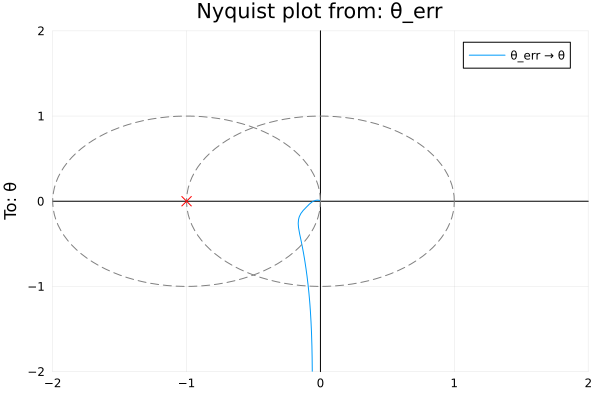

In [189]:
nyquistplot(L_θ2q; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

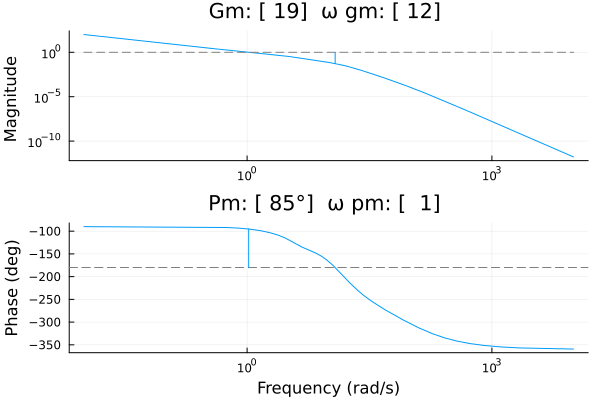

In [190]:
marginplot(L_θ2q)

StepInfo:
Initial value:     0.000
Final value:       1.001
Step size:         1.001
Peak:              1.001
Peak time:         9.315 s
Overshoot:          0.00 %
Undershoot:         0.00 %
Settling time:     3.994 s
Rise time:         1.975 s


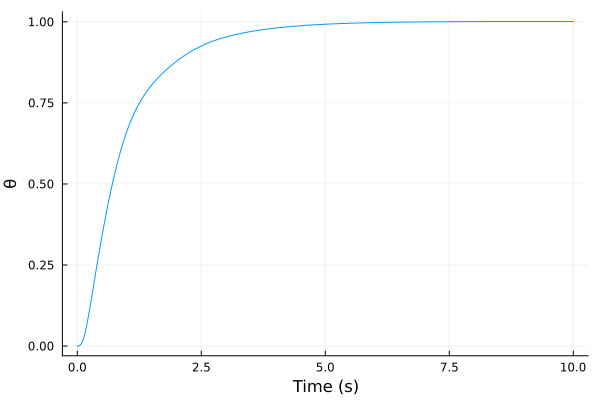

In [191]:
T_θ2q = output_comp_sensitivity(P_q2θ, C_θ2q)
T_θ2q_step = step(T_θ2q, t_sim_θ2q)
stepinfo(T_θ2q_step) |> display
T_θ2q_step |> plot

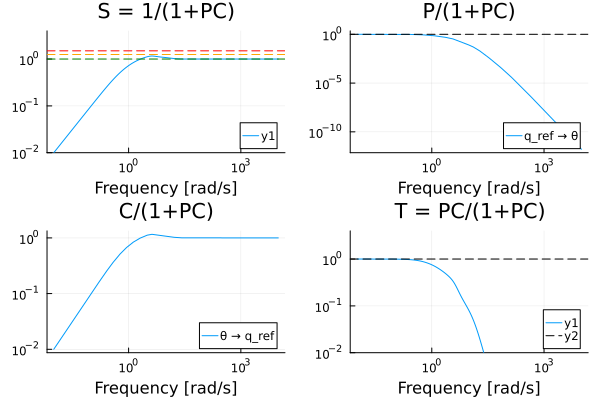

In [192]:
gangoffourplot(P_q2θ, C_θ2q)

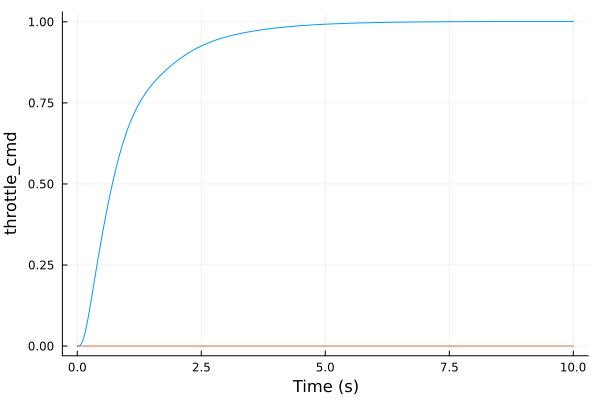

In [194]:
θ2q_sum = sumblock("θ_err = θ_ref - θ")
P_red_tθ = connect([P_red_tq, θ2q_sum, C_θ2q], [:θ_err=>:θ_err, :θ=>:θ, :q_ref=>:q_ref], w1 = [:throttle_cmd_ref, :θ_ref], z1 = P_red_tq.y);

#check we get the same response as with the SISO closed loop
θsp2θ = P_red_tθ[:θ, :θ_ref]
θsp2t = P_red_tθ[:throttle_cmd, :θ_ref]
θsp2e = P_red_tθ[:elevator_cmd, :θ_ref]
step(θsp2θ, t_sim_θ2q) |> plot
step(θsp2t, t_sim_θ2q) |> plot!
# step(θsp2e, t_sim_θ2q) |> plot!

Our linear model comes from a horizontal, wings level flight condition, in which:
$$\dot{\theta} = q$$
However, in the general case we have the following kinematic relations:
$$
q = \dot{\theta} \cos \phi + \dot{\psi} \sin \phi \cos \theta \\
\dot{\psi} = \dfrac{1}{\cos \theta} (q \sin \phi + r \cos \phi)
$$

Substituting the second equation into the first and solving for q we arrive at:
$$
q(\dot{\theta}, r, \phi) = \dfrac{1}{\cos \phi}(\dot{\theta} + r \tan \phi)
$$

This shows that, when we have nonzero $r$ and nonzero $\phi$ (for example, during a turn), maintaining $\dot{\theta} = 0$ requires nonzero $q$. Also, as $\phi$ increases, the gain from $\dot{\theta}$ to $q$ decreases.

Since the $\theta$ controller design assumes $q = \dot{\theta}$, the $q_{sp}$ output by the $\theta$ controller should actually be interpreted as $\dot{\theta}_{sp}$ (or equivalently, the $q_{sp}$ we would need to track the desired $\theta$ in the absence of $r$ and $\phi$). The actual $q_{sp}$ required is given by:
$$q_{sp}=q(\dot{\theta}_{sp}, r, \phi)$$

What would happen during a turn if we didn't introduce this feedforward correction? Since the $\theta$ controller is purely proportional, it can only generate a nonzero output for nonzero $\theta$ error. Therefore, the necessary steady state $q = r \tan \phi$ required by the turn can only be achieved by the $\theta$ controller through a nonzero steady state $\theta$ error. This means that turning would always produce a nonzero steady-state $\theta$ error. The higher the turn rate, the larger the error.

Finally, to avoid transients on mode changes, we want the initial $\theta$ loop to produce $\dot{\theta}_{sp} = 0$ when $\theta_{sp}$ is initialized to the current $\theta$. Since this is only a proportional compensator this is unconditionally true:
$$\dot{\theta}_{sp} = k_p (\theta_{sp} - \theta)$$

## 4. EAS $\rightarrow \theta$


We start from the $\theta$-augmented plant. We leave the throttle alone and design a EAS to $\theta$ SISO loop.

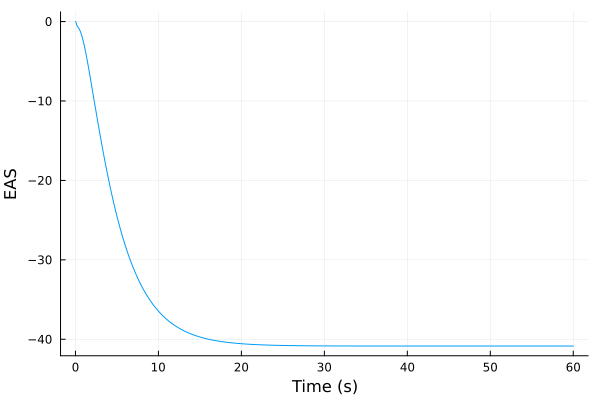

In [195]:
P_θ2v = P_red_tθ[:EAS, :θ_ref]
step(P_θ2v, 60) |> plot

As expected, we have negative DC gain, so the compensator will require a sign inversion. For design, we can move this inversion to the plant.

In [196]:
zpk(P_θ2v) |> display
P_θ2v_opt = -P_θ2v;

TransferFunction{Continuous, ControlSystemsBase.SisoZpk{Float64, ComplexF64}}
                                                        (1.0s + 49.630792037790236)(1.0s + 10.621576863981236)(1.0s^2 - 0.045935153311756315s + 12.032443086218937)(1.0s^2 + 5.434916161156149s + 25.567713554392306)(1.0s + 1.2298289239658575)
-10216.80708563873---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
                  (1.0s + 101.93851029844129)(1.0s + 49.51862271427942)(1.0s + 10.633857005725666)(1.0s^2 + 19.020993839001044s + 174.50979694258507)(1.0s^2 + 4.100626371373888s + 18.46239221581076)(1.0s + 1.538925787135944)(1.0s + 0.6928188275485724)(1.0s + 0.27048874568740966)

Continuous-time transfer function model

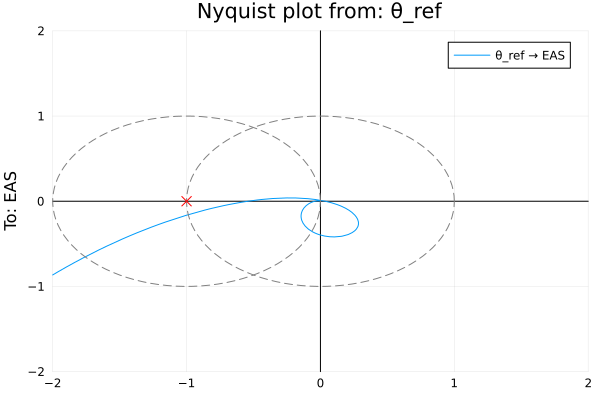

In [198]:
nyquistplot(P_θ2v_opt; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

In [200]:
t_sim_v2θ = 20
lower_bounds = PIDParams(; k_p = 0.01, k_i = 0.000, k_d = 0.0, τ_f = 0.01)
upper_bounds = PIDParams(; k_p = 0.2, k_i = 0.05, k_d = 0.0, τ_f = 0.01)
settings = Settings(; t_sim = t_sim_v2θ, lower_bounds, upper_bounds)
weights = Metrics(; Ms = 2.0, ∫e = 5.0, ef = 1.0, ∫u = 0.0, up = 0.0)
params_0 = PIDParams(; k_p = 0.05, k_i = 0.01, k_d = 0.0, τ_f = 0.01)

v2θ_results = optimize_PID(P_θ2v_opt; params_0, settings, weights, global_search)
v2θ_pid = build_PID(v2θ_results.params)
C_v2θ = -v2θ_pid
C_v2θ = named_ss(ss(C_v2θ), :C_v2θ; u = :EAS_err, y = :θ_ref)
L_v2θ = series(C_v2θ, P_θ2v);

@unpack k_p, k_i, k_d, τ_f, T_i, T_d = v2θ_results.params
@show k_p, k_i, k_d, τ_f, T_i, T_d
@show v2θ_results.metrics
@show v2θ_results.exit_flag;

(k_p, k_i, k_d, τ_f, T_i, T_d) = (0.04142060125677378, 0.008748246369476676, 0.0, 0.01, 4.734731911677011, 0.0)
v2θ_results.metrics = [1.2870778235792133, 0.1404152131259725, 0.00396940785005695, 0.9726876335017464, 0.9772046251513105]
v2θ_results.exit_flag = :ROUNDOFF_LIMITED


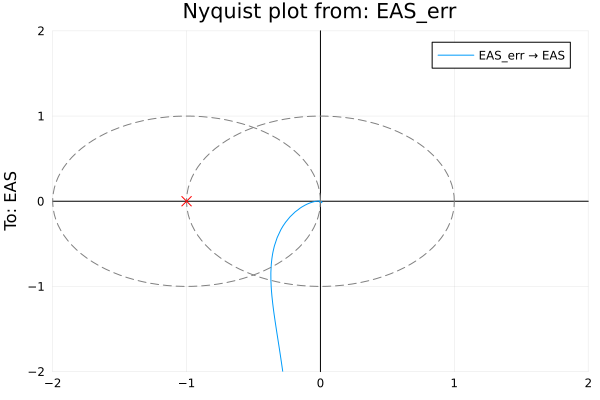

In [201]:
nyquistplot(L_v2θ; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))


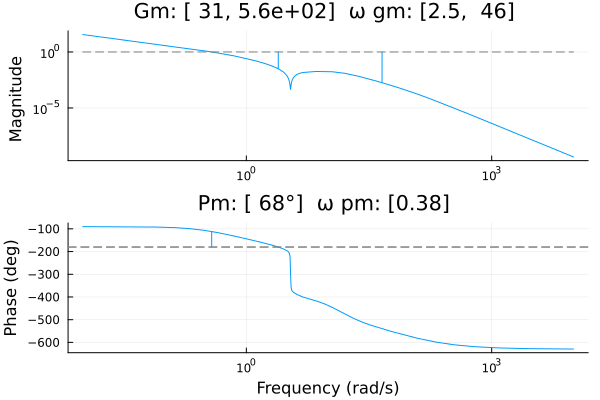

In [202]:
marginplot(L_v2θ)

StepInfo:
Initial value:     0.000
Final value:       0.996
Step size:         0.996
Peak:              1.010
Peak time:         7.351 s
Overshoot:          1.42 %
Undershoot:         0.00 %
Settling time:     5.689 s
Rise time:         3.761 s


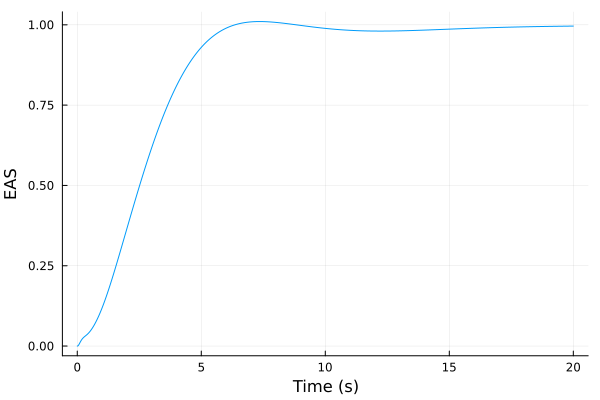

In [203]:
T_v2θ = output_comp_sensitivity(P_θ2v, C_v2θ)
T_v2θ_step = step(T_v2θ, t_sim_v2θ)
stepinfo(T_v2θ_step) |> display
T_v2θ_step |> plot

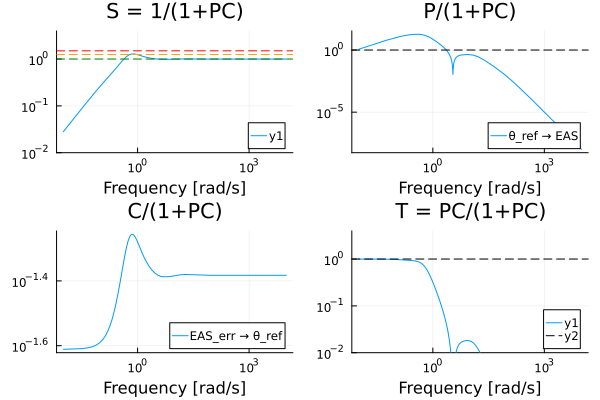

In [204]:
gangoffourplot(P_θ2v, C_v2θ)

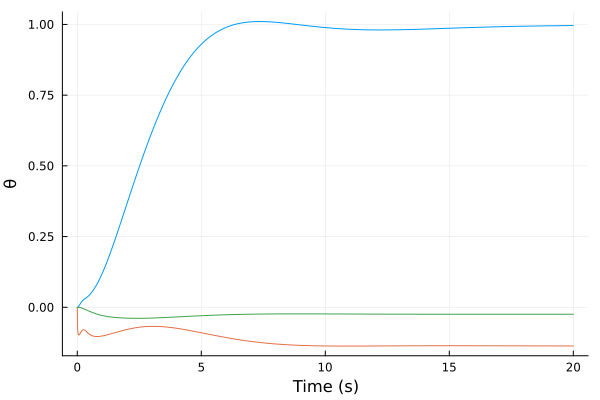

In [206]:
v2θ_sum = sumblock("EAS_err = EAS_ref - EAS")
P_red_tv = connect([P_red_tθ, v2θ_sum, C_v2θ], [:EAS_err=>:EAS_err, :EAS=>:EAS, :θ_ref=>:θ_ref], w1 = [:throttle_cmd_ref, :EAS_ref], z1 = P_red_tθ.y)

#check we get the same response as with the SISO closed loop
EASsp2EAS = P_red_tv[:EAS, :EAS_ref]
EASsp2e = P_red_tv[:elevator_cmd, :EAS_ref]
EASsp2θ = P_red_tv[:θ, :EAS_ref]
step(EASsp2EAS, t_sim_v2θ) |> plot
step(EASsp2e, t_sim_v2θ) |> plot!
step(EASsp2θ, t_sim_v2θ) |> plot!

To avoid transients on mode changes, we want the initial $\theta_{sp}$ output from the $v2\theta$ controller to match the current value of pitch angle $\theta$ when $EAS_{sp}$ matches the current $EAS$.

Whenever $v2\theta$ is enabled after a mode change, we reset the PID. Then we set the PID integrator's state to the appropriate value to achieve the required $\theta$. Noting the sign inversion, we have:
$$ y_{pid} = k_p (EAS_{sp} - EAS) + k_i x_{i0} = k_i x_{i0} $$
$$ \theta_{sp} = -y_{pid}$$

Therefore:
$$x_{i0} = y_{pid} / k_i = -\theta_{sp}/k_i = -\theta/k_i$$

## 5. $EAS \rightarrow t$

To design a SISO EAS-to-throttle controller, we should start from a plant with pitch control augmentation. The throttle-to-EAS response of the raw plant is unsuitable.

|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| -0.27              |  1            |  0.27         |  0.043        |  3.7          |
| -0.693             |  1            |  0.693        |  0.11         |  1.44         |
| -1.54              |  1            |  1.54         |  0.245        |  0.65         |
| -2.05   ±   3.78im |  0.477        |  4.3          |  0.684        |  0.488        |
| -10.6              |  1            |  10.6         |  1.69         |  0.094        |
| -9.51   ±   9.17im |  0.72         |  13.2         |  2.1          |  0.105        |
| -20                |  1            |  20           |  3.18         |  0.05         |
| -49.5              |  1            |  49.5         |  7.88         |  0.0202       |
| -102               |  1            |  102

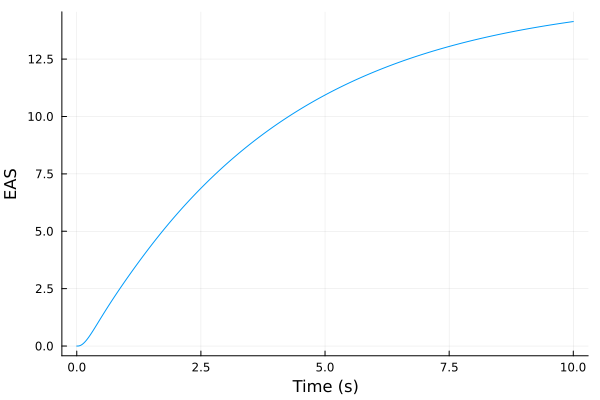

In [208]:
P_t2v = P_red_tθ[:EAS, :throttle_cmd]

dampreport(P_t2v)
step(P_t2v, 10) |> plot

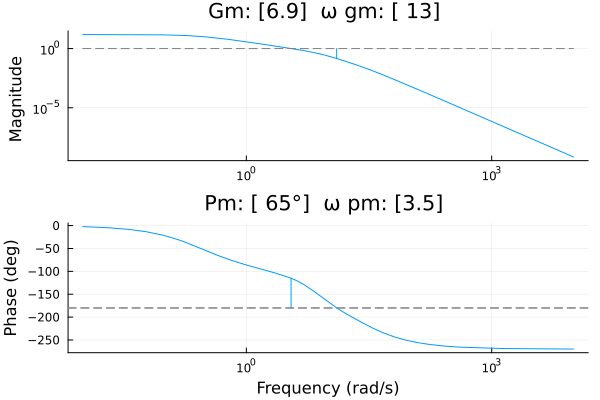

In [209]:
#error transfer function for a unit feedback closed loop and a unit step input
marginplot(P_t2v)

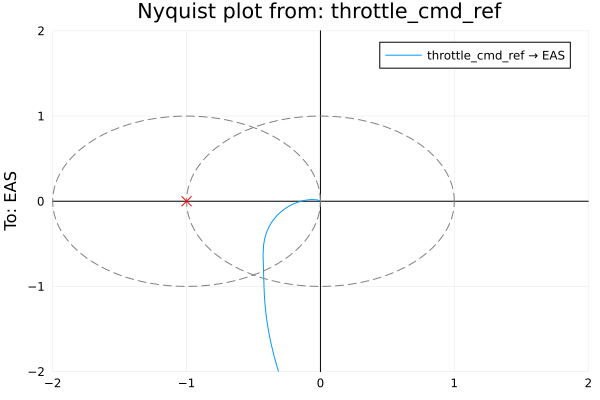

In [210]:
nyquistplot(P_t2v; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

In [211]:
t_sim_v2t = 10
lower_bounds = PIDParams(; k_p = 0.1, k_i = 0.0, k_d = 0.0, τ_f = 0.01)
upper_bounds = PIDParams(; k_p = 1.5, k_i = 0.5, k_d = 0.0, τ_f = 0.01)
settings = Settings(; t_sim = t_sim_v2t, maxeval = 5000, lower_bounds, upper_bounds)
weights = Metrics(; Ms = 2.0, ∫e = 5.0, ef = 1.0, ∫u = 0.0, up = 0.0)
params_0 = PIDParams(; k_p = 0.2, k_i = 0.1, k_d = 0.0, τ_f = 0.01)

v2t_results = optimize_PID(P_t2v; params_0, settings, weights, global_search)
v2t_PID = build_PID(v2t_results.params)

C_v2t = named_ss(ss(v2t_PID), :C_v2t; u = :EAS_err, y = :throttle_cmd_ref)
L_v2t = series(C_v2t, P_t2v)

@unpack k_p, k_i, k_d, T_i, T_d = v2t_results.params
@show k_p, k_i, k_d, T_i, T_d
@show v2t_results.metrics
@show v2t_results.exit_flag

(k_p, k_i, k_d, T_i, T_d) = (0.3502622659004639, 0.09197279922858533, 0.0, 3.808324513750384, 0.0)
v2t_results.metrics = [1.1637247786692237, 0.07300776962435147, 0.00045736257752970744, 0.9130470182864303, 0.9360593974842086]
v2t_results.exit_flag = :ROUNDOFF_LIMITED


:ROUNDOFF_LIMITED

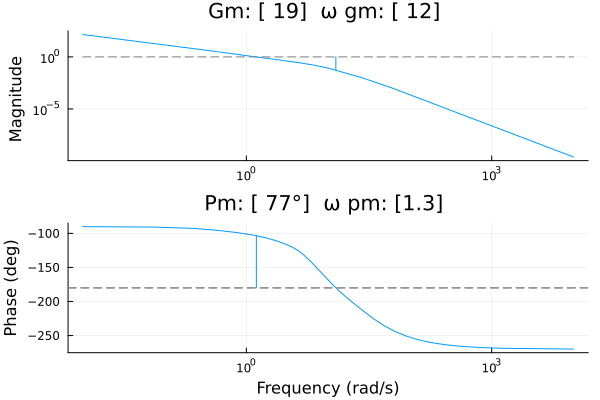

In [212]:
marginplot(L_v2t)

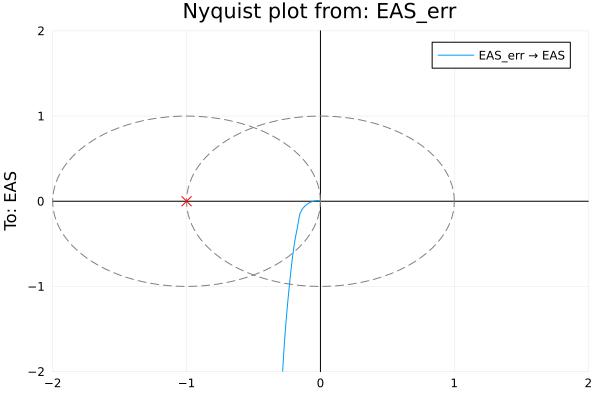

In [213]:
nyquistplot(L_v2t; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

StepInfo:
Initial value:     0.000
Final value:       1.000
Step size:         1.000
Peak:              1.005
Peak time:         3.414 s
Overshoot:          0.57 %
Undershoot:         0.00 %
Settling time:     2.050 s
Rise time:         1.236 s


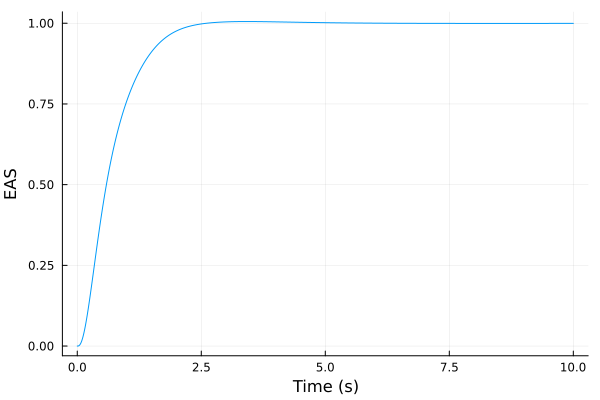

In [214]:
T_v2t = output_comp_sensitivity(P_t2v, C_v2t)
T_v2t_step = step(T_v2t, t_sim_v2t)
stepinfo(T_v2t_step) |> display
T_v2t_step |> plot

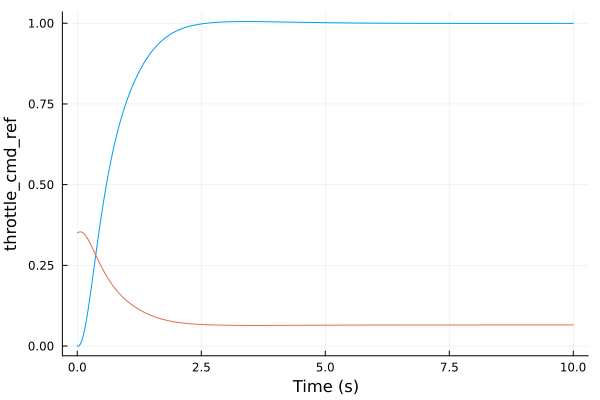

In [215]:
CS_v2t = G_CS(P_t2v, C_v2t)
CS_v2t_step = step(CS_v2t, t_sim_v2t)
CS_v2t_step |> plot!

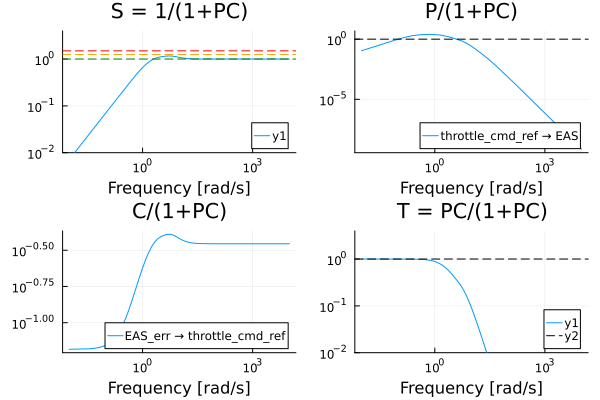

In [216]:
gangoffourplot(P_t2v, C_v2t)

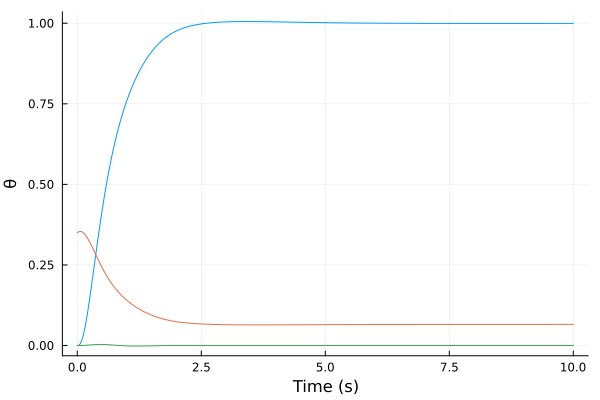

In [217]:
v2t_sum = sumblock("EAS_err = EAS_ref - EAS")
P_red_vθ = connect([P_red_tθ, v2t_sum, C_v2t], [:EAS_err=>:EAS_err, :EAS=>:EAS, :throttle_cmd_ref=>:throttle_cmd_ref], w1 = [:EAS_ref, :θ_ref], z1 = P_red_tθ.y)

#check we get the same response as with the SISO closed loop
EASsp2EAS = P_red_vθ[:EAS, :EAS_ref]
EASsp2thr = P_red_vθ[:throttle_cmd, :EAS_ref]
EASsp2θ = P_red_vθ[:θ, :EAS_ref]
step(EASsp2EAS, t_sim_v2t) |> plot
step(EASsp2thr, t_sim_v2t) |> plot!
step(EASsp2θ, t_sim_v2t) |> plot!

To avoid transients on mode changes, we want the initial throttle command reference $thr_{ref}$ output from the $v2t$ controller to match the current value of throttle command $thr$ when $EAS_{sp}$ matches the current $EAS$. Whenever $v2t$ is enabled after a mode change, we reset the PID. Then we set the PID integrator's state to the appropriate value to achieve the required $thr$. We have:
$$thr_{ref} = y_{pid} = k_p (EAS_{ref} - EAS) + k_i x_{i0} = k_i x_{i0} = thr $$

Therefore:
$$x_{i0} = thr/k_i$$

## 6. Climb Rate $\rightarrow \theta$

We assume that this mode will be used together with some form of airspeed control, be it manual or automatic. If airspeed were not maintained, it is likely that in some parts of the envelope, an increase in $\theta$ will actually lead to an altitude loss after an initial surge. Thus, we start from the plant with closed-loop airspeed control via throttle. This scenario corresponds to the altitude hold mode.

|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| -0.261             |  1            |  0.261        |  0.0415       |  3.83         |
| -0.875             |  1            |  0.875        |  0.139        |  1.14         |
| -1.29              |  1            |  1.29         |  0.205        |  0.776        |
| -1.9               |  1            |  1.9          |  0.302        |  0.527        |
| -2.14   ±   3.82im |  0.489        |  4.37         |  0.696        |  0.468        |
| -6.77              |  1            |  6.77         |  1.08         |  0.148        |
| -9.82   ±   9.16im |  0.731        |  13.4         |  2.14         |  0.102        |
| -21.2              |  1            |  21.2         |  3.38         |  0.0471       |
| -49.5              |  1            |  49.

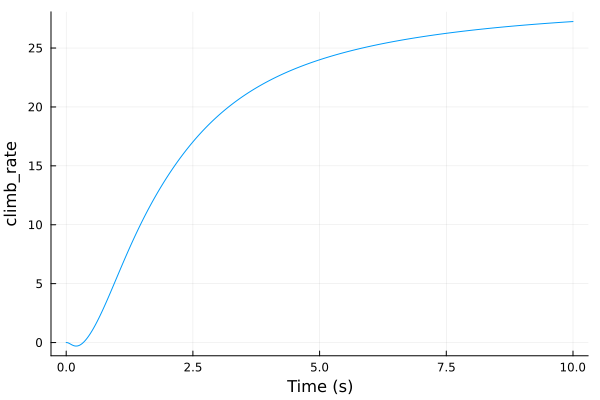

In [218]:
P_θ2c = P_red_vθ[:climb_rate, :θ_ref]

dampreport(P_θ2c)
step(P_θ2c, 10) |> plot

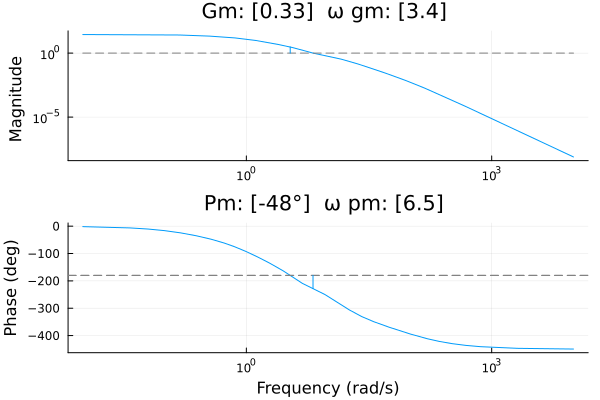

In [219]:
#error transfer function for a unit feedback closed loop and a unit step input
marginplot(P_θ2c)

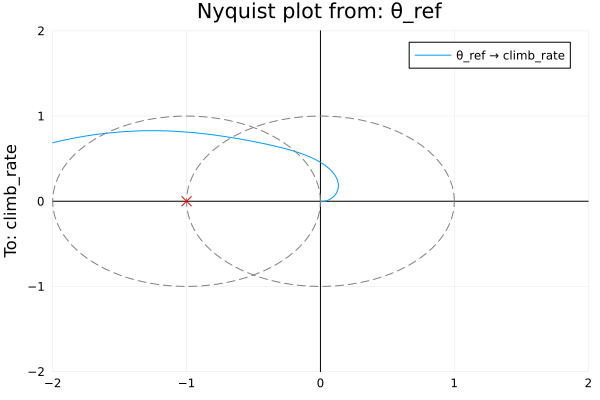

In [220]:
nyquistplot(P_θ2c; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

In [221]:
t_sim_c2θ = 10
lower_bounds = PIDParams(; k_p = 0.001, k_i = 0.001, k_d = 0.0, τ_f = 0.01)
upper_bounds = PIDParams(; k_p = 0.05, k_i = 0.03, k_d = 0.0, τ_f = 0.01)
settings = Settings(; t_sim = t_sim_c2θ, maxeval = 5000, lower_bounds, upper_bounds)
weights = Metrics(; Ms = 2.0, ∫e = 3.0, ef = 1.0, ∫u = 0.0, up = 0.1)
params_0 = PIDParams(; k_p = 0.02, k_i = 0.01, k_d = 0.0, τ_f = 0.01)

c2θ_results = optimize_PID(P_θ2c; params_0, settings, weights, global_search)
c2θ_PID = build_PID(c2θ_results.params)

C_c2θ = named_ss(ss(c2θ_PID), :C_c2θ; u = :climb_rate_err, y = :θ_ref)
L_c2θ = series(C_c2θ, P_θ2c)

@unpack k_p, k_i, k_d, T_i, T_d = c2θ_results.params
@show k_p, k_i, k_d, T_i, T_d
@show c2θ_results.metrics
@show c2θ_results.exit_flag

(k_p, k_i, k_d, T_i, T_d) = (0.03468296213180261, 0.01849974908784712, 0.0, 1.8747801371309725, 0.0)
c2θ_results.metrics = [1.2549381912772875, 0.2052624216383634, 0.01486198163485497, 0.961142968860784, 0.9653170378681974]
c2θ_results.exit_flag = :ROUNDOFF_LIMITED


:ROUNDOFF_LIMITED

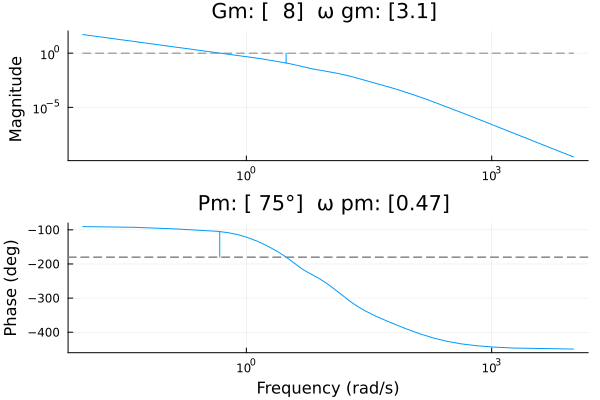

In [222]:
marginplot(L_c2θ)

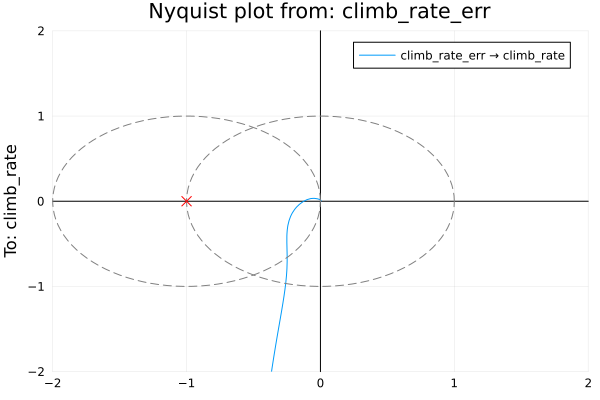

In [223]:
nyquistplot(L_c2θ; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

StepInfo:
Initial value:     0.000
Final value:       1.015
Step size:         1.015
Peak:              1.015
Peak time:         9.846 s
Overshoot:          0.00 %
Undershoot:         1.08 %
Settling time:     6.477 s
Rise time:         3.316 s


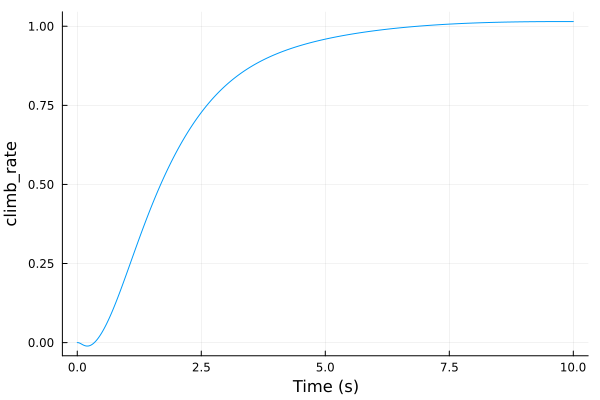

In [224]:
T_c2θ = output_comp_sensitivity(P_θ2c, C_c2θ)
T_c2θ_step = step(T_c2θ, t_sim_c2θ)
stepinfo(T_c2θ_step) |> display
T_c2θ_step |> plot

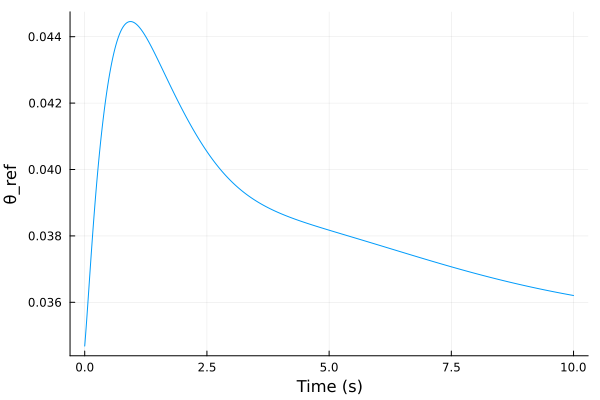

In [225]:
CS_c2θ = G_CS(P_θ2c, C_c2θ)
CS_c2θ_step = step(CS_c2θ, t_sim_c2θ)
CS_c2θ_step |> plot

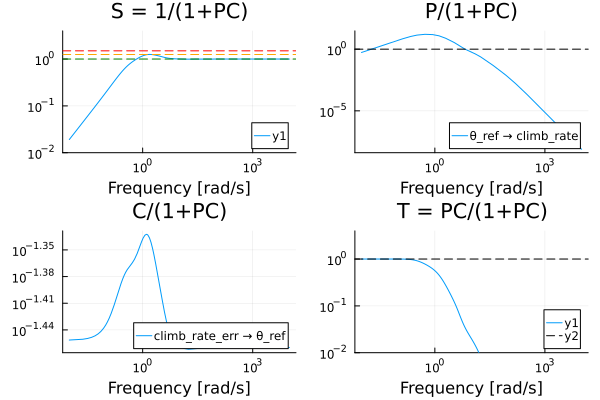

In [226]:
gangoffourplot(P_θ2c, C_c2θ)

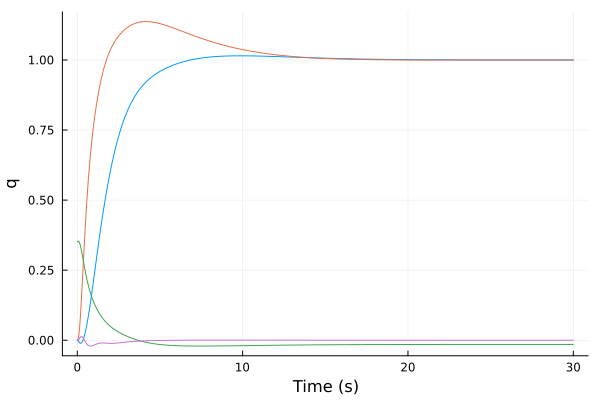

In [235]:
c2θ_sum = sumblock("climb_rate_err = climb_rate_ref - climb_rate")
P_red_vc = connect([P_red_vθ, c2θ_sum, C_c2θ], [:climb_rate_err=>:climb_rate_err, :climb_rate=>:climb_rate, :θ_ref=>:θ_ref], w1 = [:EAS_ref, :climb_rate_ref], z1 = P_red_vθ.y)

#check we get the same response as with the SISO closed loop
crsp2cr = P_red_vc[:climb_rate, :climb_rate_ref]
EASsp2EAS = P_red_vc[:EAS, :EAS_ref]
EASsp2thr = P_red_vc[:throttle_cmd, :EAS_ref]
EASsp2q = P_red_vc[:q, :EAS_ref]
step(crsp2cr, 30) |> plot
step(EASsp2EAS, 30) |> plot!
step(EASsp2thr, 30) |> plot!
step(EASsp2q, 30) |> plot!

To avoid transients on mode changes, we want the initial $\theta_{sp}$ output from the $c2\theta$ controller to match the current value of pitch angle $\theta$ when $c_{sp}$ matches the current climb rate.

Whenever $c2\theta$ is enabled after a mode change, we reset the PID. Then we set the PID integrator's state to the appropriate value to achieve the required $\theta$. We have:
$$ y_{pid} = k_p (clm_{sp} - clm) + k_i x_{i0} = k_i x_{i0} $$
$$ \theta_{sp} = y_{pid}$$

Therefore:
$$x_{i0} = y_{pid} / k_i = \theta_{sp}/k_i = \theta/k_i$$

## 7. $h \rightarrow c$

Now we address the design an altitude hold loop, assuming EAS and climb rate tracking are already
available. However, all of our previous compensators and intermediate plants have been built from
the reduced longitudinal dynamics, so the resulting `P_red_vc` does not have $h$ as a state. We need
to go back to the complete longitudinal dynamics, and then build the corresponding `P_full_vc` by
connecting the designed compensators in the same order as before: SAS, pitch rate, pitch angle, EAS,
and climb rate. Thus, we start from the EAS + climb rate plant.


In [236]:
P_full_te = connect([P_full, elevator_sum, C_fbk_ss, C_fwd_ss],
    connections; w1 = [:throttle_cmd, :elevator_cmd_ref], z1 = P_full.y)

#add dummy system to rename input throttle_cmd to throttle_cmd_ref
D_thr = named_ss(ss(1), u = [:throttle_cmd_ref,], y = [:throttle_cmd_ref, ])
P_full_te = connect([P_full_te, D_thr], [:throttle_cmd_ref => :throttle_cmd,];
    w1 = [:throttle_cmd_ref, :elevator_cmd_ref], z1 = P_full_te.y)

P_full_tq = connect([P_full_te, q2e_sum, C_q2e], [:q_err=>:q_err, :q=>:q, :elevator_cmd_ref=>:elevator_cmd_ref], w1 = [:throttle_cmd_ref, :q_ref], z1 = P_full_te.y)
P_full_tθ = connect([P_full_tq, θ2q_sum, C_θ2q], [:θ_err=>:θ_err, :θ=>:θ, :q_ref=>:q_ref], w1 = [:throttle_cmd_ref, :θ_ref], z1 = P_full_tq.y);
P_full_vθ = connect([P_full_tθ, v2t_sum, C_v2t], [:EAS_err=>:EAS_err, :EAS=>:EAS, :throttle_cmd_ref=>:throttle_cmd_ref], w1 = [:EAS_ref, :θ_ref], z1 = P_full_tθ.y)
P_full_vc = connect([P_full_vθ, c2θ_sum, C_c2θ], [:climb_rate_err=>:climb_rate_err, :climb_rate=>:climb_rate, :θ_ref=>:θ_ref], w1 = [:EAS_ref, :climb_rate_ref], z1 = P_full_vθ.y)

dampreport(P_red_tq)
dampreport(P_full_tq)

|        Pole        |   Damping     |   Frequency   |   Frequency   | Time Constant |
|                    |    Ratio      |   (rad/sec)   |     (Hz)      |     (sec)     |
+--------------------+---------------+---------------+---------------+---------------+
| -6.46e-06          |  1            |  6.46e-06     |  1.03e-06     |  1.55e+05     |
| -0.258             |  1            |  0.258        |  0.041        |  3.88         |
| -0.963             |  1            |  0.963        |  0.153        |  1.04         |
| -2.27   ±   3.78im |  0.515        |  4.41         |  0.702        |  0.441        |
| -10.6              |  1            |  10.6         |  1.69         |  0.094        |
| -9.92   ±   9.69im |  0.715        |  13.9         |  2.21         |  0.101        |
| -20                |  1            |  20           |  3.18         |  0.05         |
| -49.5              |  1            |  49.5         |  7.88         |  0.0202       |
| -102               |  1            |  102

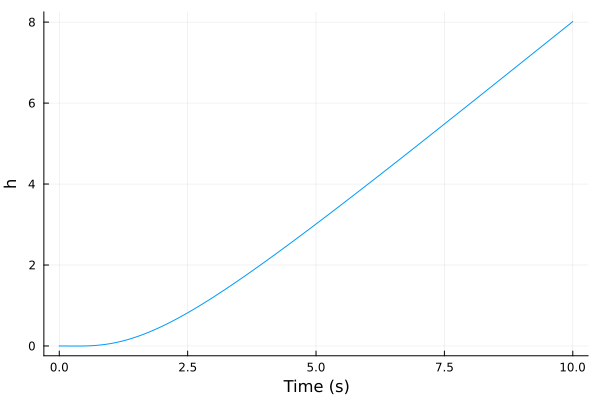

In [238]:
P_c2h = P_full_vc[:h, :climb_rate_ref]
step(P_c2h, 10) |> plot

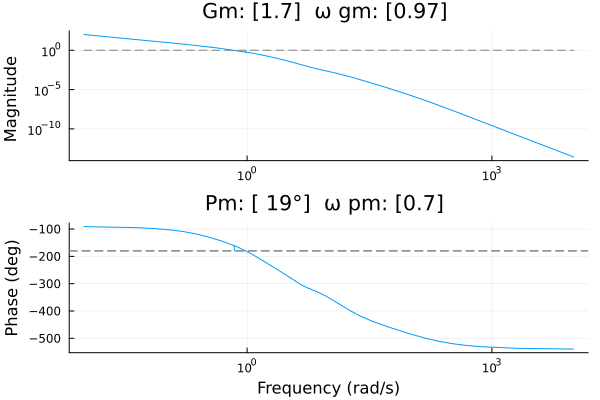

In [239]:
marginplot(P_c2h)

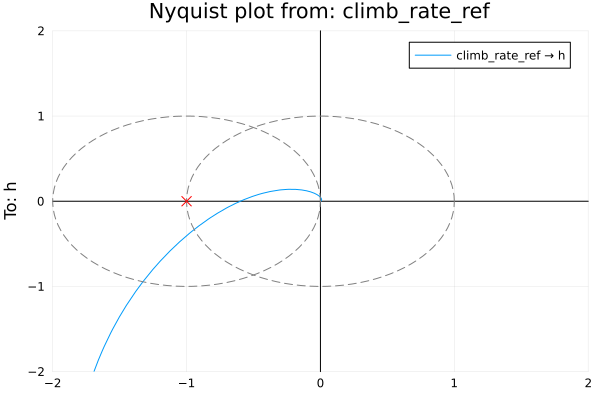

In [240]:
nyquistplot(P_c2h; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

In [241]:
k_h2c = 0.2
C_h2c = named_ss(ss(k_h2c), :C_h2c; u = :h_err, y = :climb_rate_ref);
L_h2c = series(C_h2c, P_c2h);

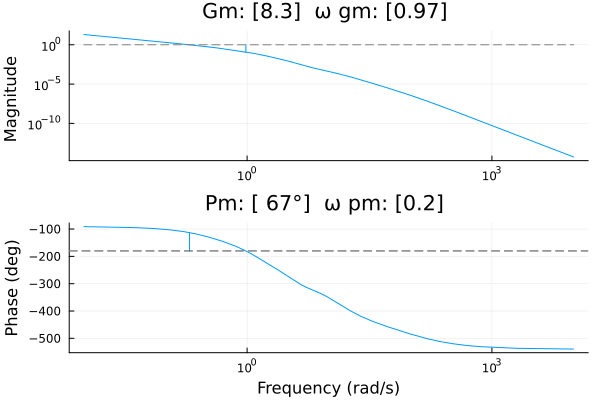

In [242]:
marginplot(L_h2c)

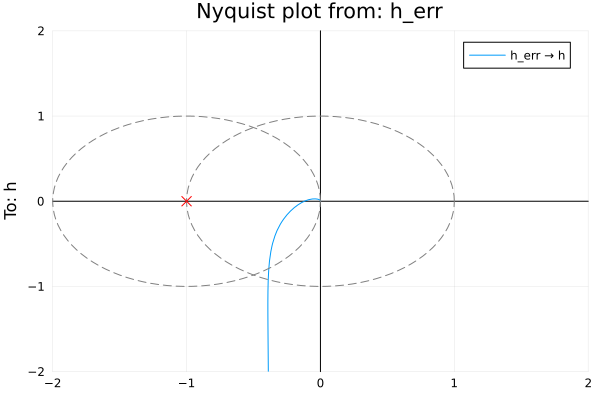

In [243]:
nyquistplot(L_h2c; unit_circle = true, Ms_circles = [1.0])
plot!(ylims = (-2,2), xlims = (-2,2))

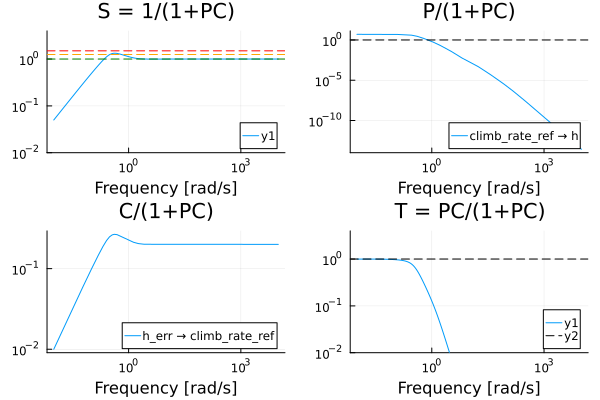

In [244]:
gangoffourplot(P_c2h, C_h2c)